# Import Library

In [ ]:
import warnings
warnings.filterwarnings('ignore')

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

In [ ]:
from google.colab import drive
drive.mount('/content/drive')
df = pd.read_csv("/content/drive/MyDrive/loan_data_2007_2014.csv")

Mounted at /content/drive


In [ ]:
df.head()

,Unnamed: 0,id,member_id,loan_amnt,funded_amnt,funded_amnt_inv,term,int_rate,installment,grade,...,total_bal_il,il_util,open_rv_12m,open_rv_24m,max_bal_bc,all_util,total_rev_hi_lim,inq_fi,total_cu_tl,inq_last_12m
0,0,1077501,1296599,5000,5000,4975.0,36 months,10.65,162.87,B,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1,1077430,1314167,2500,2500,2500.0,60 months,15.27,59.83,C,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2,1077175,1313524,2400,2400,2400.0,36 months,15.96,84.33,C,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,3,1076863,1277178,10000,10000,10000.0,36 months,13.49,339.31,C,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,4,1075358,1311748,3000,3000,3000.0,60 months,12.69,67.79,B,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 466285 entries, 0 to 466284
Data columns (total 75 columns):
 #   Column                       Non-Null Count   Dtype  
---  ------                       --------------   -----  
 0   Unnamed: 0                   466285 non-null  int64  
 1   id                           466285 non-null  int64  
 2   member_id                    466285 non-null  int64  
 3   loan_amnt                    466285 non-null  int64  
 4   funded_amnt                  466285 non-null  int64  
 5   funded_amnt_inv              466285 non-null  float64
 6   term                         466285 non-null  object 
 7   int_rate                     466285 non-null  float64
 8   installment                  466285 non-null  float64
 9   grade                        466285 non-null  object 
 10  sub_grade                    466285 non-null  object 
 11  emp_title                    438697 non-null  object 
 12  emp_length                   445277 non-null  object 
 13 

# Data Preparation

In [ ]:
selected_columns = ['term','home_ownership', 'verification_status', 'loan_status', 'pymnt_plan', 'purpose', 'initial_list_status', 'annual_inc', 'loan_amnt',
'int_rate','dti', 'revol_bal', 'total_pymnt','delinq_2yrs', 'inq_last_6mths', 'open_acc', 'pub_rec', 'revol_util', 'total_acc', 'out_prncp','total_rec_prncp', 'total_rec_int',
'total_rec_late_fee', 'recoveries', 'collection_recovery_fee', 'last_pymnt_amnt', 'collections_12_mths_ex_med', 'acc_now_delinq',
'issue_d', 'last_pymnt_d', 'earliest_cr_line', 'last_credit_pull_d','grade', 'emp_length', 'addr_state']

# Memfilter dataset hanya dengan kolom yang diperlukan
df = df[selected_columns]

In [ ]:
df.to_csv('final.csv', index=False)

In [ ]:
bad_loans = ['Charged Off', 'Default', 'Late (31-120 days)', 'Does not meet the credit policy. Status:Charged Off']

# create new column to classify ending
df['good_and_bad_loan'] = np.where(df['loan_status'].isin(bad_loans), 1, 0)

<Axes: title={'center': 'Good (0) vs Bad (1) Loans Balance'}, xlabel='good_and_bad_loan'>

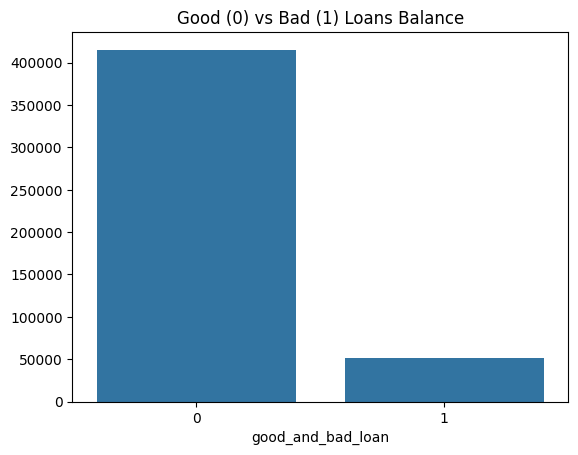

In [ ]:
plt.title('Good (0) vs Bad (1) Loans Balance')
sns.barplot(x=df.good_and_bad_loan.value_counts().index,y=df.good_and_bad_loan.value_counts().values)

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 466285 entries, 0 to 466284
Data columns (total 36 columns):
 #   Column                      Non-Null Count   Dtype  
---  ------                      --------------   -----  
 0   term                        466285 non-null  object 
 1   home_ownership              466285 non-null  object 
 2   verification_status         466285 non-null  object 
 3   loan_status                 466285 non-null  object 
 4   pymnt_plan                  466285 non-null  object 
 5   purpose                     466285 non-null  object 
 6   initial_list_status         466285 non-null  object 
 7   annual_inc                  466281 non-null  float64
 8   loan_amnt                   466285 non-null  int64  
 9   int_rate                    466285 non-null  float64
 10  dti                         466285 non-null  float64
 11  revol_bal                   466285 non-null  int64  
 12  total_pymnt                 466285 non-null  float64
 13  delinq_2yrs   

# Explanatory Data Analysis (EDA)

## Check Correlation

In [ ]:
df.isna().sum()

,0
term,0
home_ownership,0
verification_status,0
loan_status,0
pymnt_plan,0
purpose,0
initial_list_status,0
annual_inc,4
loan_amnt,0
int_rate,0


In [ ]:
df_clean = df.dropna()
df_clean.info()

<class 'pandas.core.frame.DataFrame'>
Index: 444451 entries, 0 to 466284
Data columns (total 36 columns):
 #   Column                      Non-Null Count   Dtype  
---  ------                      --------------   -----  
 0   term                        444451 non-null  object 
 1   home_ownership              444451 non-null  object 
 2   verification_status         444451 non-null  object 
 3   loan_status                 444451 non-null  object 
 4   pymnt_plan                  444451 non-null  object 
 5   purpose                     444451 non-null  object 
 6   initial_list_status         444451 non-null  object 
 7   annual_inc                  444451 non-null  float64
 8   loan_amnt                   444451 non-null  int64  
 9   int_rate                    444451 non-null  float64
 10  dti                         444451 non-null  float64
 11  revol_bal                   444451 non-null  int64  
 12  total_pymnt                 444451 non-null  float64
 13  delinq_2yrs        

In [ ]:
df_num = df_clean.select_dtypes(include=['number'])
df_cat = df_clean.select_dtypes(include=['object'])

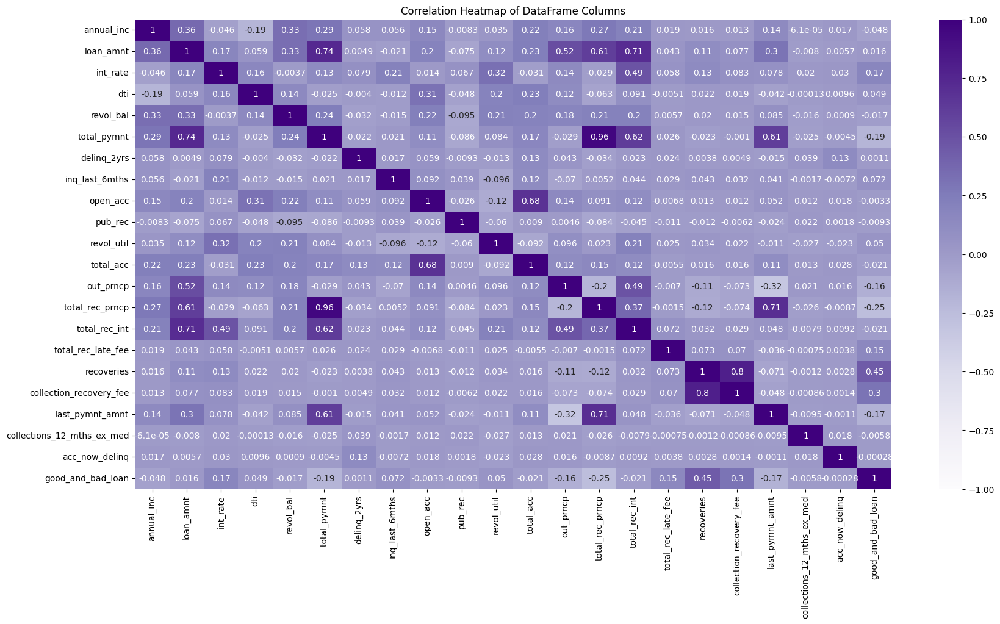

In [ ]:
corr_matrix = df_num.corr()
plt.figure(figsize=(20, 10))
sns.heatmap(corr_matrix, annot=True, cmap='Purples', vmin=-1, vmax=1)
plt.title('Correlation Heatmap of DataFrame Columns')
plt.show()

In [ ]:
def convert_to_full_year_with_month(data_str):
    if pd.isnull(data_str):
        return None
    month, year = data_str.split('-')
    year = int(year)
    if year >= 40:
        year_str = f'19{year}'
    else:
        year_str = f'20{year:02d}'
    return f'{month}-{year_str}'

In [ ]:
date_columns = ['issue_d', 'last_pymnt_d', 'earliest_cr_line', 'last_credit_pull_d']
for col in date_columns:
    df_clean[col] = df_clean[col].apply(convert_to_full_year_with_month)
    df_clean[col] = pd.to_datetime(df_clean[col], format='%b-%Y')

# Menghitung payment_time dalam bulan
df_clean['payment_time'] = (df_clean['last_pymnt_d'].dt.year - df_clean['issue_d'].dt.year) * 12 + \
                     (df_clean['last_pymnt_d'].dt.month - df_clean['issue_d'].dt.month)

# Menghitung loan_time dalam bulan
df_clean['loan_time'] = (df_clean['last_credit_pull_d'].dt.year - df_clean['earliest_cr_line'].dt.year) * 12 + \
                  (df_clean['last_credit_pull_d'].dt.month - df_clean['earliest_cr_line'].dt.month)

df_clean

,term,home_ownership,verification_status,loan_status,pymnt_plan,purpose,initial_list_status,annual_inc,loan_amnt,int_rate,...,issue_d,last_pymnt_d,earliest_cr_line,last_credit_pull_d,grade,emp_length,addr_state,good_and_bad_loan,payment_time,loan_time
0,36 months,RENT,Verified,Fully Paid,n,credit_card,f,24000.0,5000,10.65,...,2011-12-01,2015-01-01,1985-01-01,2016-01-01,B,10+ years,AZ,0,37,372
1,60 months,RENT,Source Verified,Charged Off,n,car,f,30000.0,2500,15.27,...,2011-12-01,2013-04-01,1999-04-01,2013-09-01,C,< 1 year,GA,1,16,173
2,36 months,RENT,Not Verified,Fully Paid,n,small_business,f,12252.0,2400,15.96,...,2011-12-01,2014-06-01,2001-11-01,2016-01-01,C,10+ years,IL,0,30,170
3,36 months,RENT,Source Verified,Fully Paid,n,other,f,49200.0,10000,13.49,...,2011-12-01,2015-01-01,1996-02-01,2015-01-01,C,10+ years,CA,0,37,227
4,60 months,RENT,Source Verified,Current,n,other,f,80000.0,3000,12.69,...,2011-12-01,2016-01-01,1996-01-01,2016-01-01,B,1 year,OR,0,49,240
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
466280,60 months,MORTGAGE,Source Verified,Current,n,debt_consolidation,w,110000.0,18400,14.47,...,2014-01-01,2016-01-01,2003-04-01,2016-01-01,C,4 years,TX,0,24,153
466281,60 months,MORTGAGE,Verified,Charged Off,n,debt_consolidation,f,78000.0,22000,19.97,...,2014-01-01,2014-12-01,1997-06-01,2016-01-01,D,10+ years,TN,1,11,223
466282,60 months,MORTGAGE,Verified,Current,n,debt_consolidation,f,46000.0,20700,16.99,...,2014-01-01,2016-01-01,2001-12-01,2015-12-01,D,7 years,OH,0,24,168
466283,36 months,OWN,Verified,Fully Paid,n,credit_card,w,83000.0,2000,7.90,...,2014-01-01,2014-12-01,2003-02-01,2015-04-01,A,3 years,CA,0,11,146


In [ ]:
columns_to_drop = ['total_rec_prncp', 'collection_recovery_fee']

# Menghapus kolom dari DataFrame secara permanen
df_clean.drop(columns=columns_to_drop, axis=1, inplace=True)

# Tampilkan DataFrame hasil
df_clean

,term,home_ownership,verification_status,loan_status,pymnt_plan,purpose,initial_list_status,annual_inc,loan_amnt,int_rate,...,issue_d,last_pymnt_d,earliest_cr_line,last_credit_pull_d,grade,emp_length,addr_state,good_and_bad_loan,payment_time,loan_time
0,36 months,RENT,Verified,Fully Paid,n,credit_card,f,24000.0,5000,10.65,...,2011-12-01,2015-01-01,1985-01-01,2016-01-01,B,10+ years,AZ,0,37,372
1,60 months,RENT,Source Verified,Charged Off,n,car,f,30000.0,2500,15.27,...,2011-12-01,2013-04-01,1999-04-01,2013-09-01,C,< 1 year,GA,1,16,173
2,36 months,RENT,Not Verified,Fully Paid,n,small_business,f,12252.0,2400,15.96,...,2011-12-01,2014-06-01,2001-11-01,2016-01-01,C,10+ years,IL,0,30,170
3,36 months,RENT,Source Verified,Fully Paid,n,other,f,49200.0,10000,13.49,...,2011-12-01,2015-01-01,1996-02-01,2015-01-01,C,10+ years,CA,0,37,227
4,60 months,RENT,Source Verified,Current,n,other,f,80000.0,3000,12.69,...,2011-12-01,2016-01-01,1996-01-01,2016-01-01,B,1 year,OR,0,49,240
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
466280,60 months,MORTGAGE,Source Verified,Current,n,debt_consolidation,w,110000.0,18400,14.47,...,2014-01-01,2016-01-01,2003-04-01,2016-01-01,C,4 years,TX,0,24,153
466281,60 months,MORTGAGE,Verified,Charged Off,n,debt_consolidation,f,78000.0,22000,19.97,...,2014-01-01,2014-12-01,1997-06-01,2016-01-01,D,10+ years,TN,1,11,223
466282,60 months,MORTGAGE,Verified,Current,n,debt_consolidation,f,46000.0,20700,16.99,...,2014-01-01,2016-01-01,2001-12-01,2015-12-01,D,7 years,OH,0,24,168
466283,36 months,OWN,Verified,Fully Paid,n,credit_card,w,83000.0,2000,7.90,...,2014-01-01,2014-12-01,2003-02-01,2015-04-01,A,3 years,CA,0,11,146


Melakukan penghapus pada fitur yang memiliki nilai korelasi diatas 75% dengan pertimbangan batas maksimal yang bagus untuk saling berkorelasi adalah 75%

In [ ]:
df_num1 = df_clean.select_dtypes(include=['number'])
df_cat1 = df_clean.select_dtypes(include=['object'])

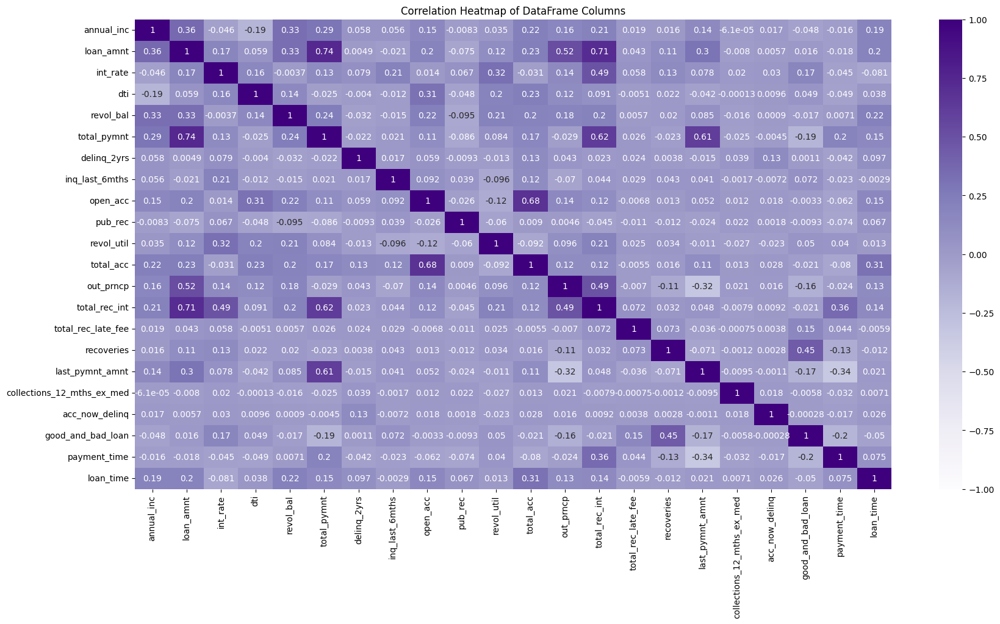

In [ ]:
corr_matrix = df_num1.corr()
plt.figure(figsize=(20, 10))
sns.heatmap(corr_matrix, annot=True, cmap='Purples', vmin=-1, vmax=1)
plt.title('Correlation Heatmap of DataFrame Columns')
plt.show()

## Univariate Analysis

### Numeric Features

In [ ]:
df_num1.info()

<class 'pandas.core.frame.DataFrame'>
Index: 444451 entries, 0 to 466284
Data columns (total 22 columns):
 #   Column                      Non-Null Count   Dtype  
---  ------                      --------------   -----  
 0   annual_inc                  444451 non-null  float64
 1   loan_amnt                   444451 non-null  int64  
 2   int_rate                    444451 non-null  float64
 3   dti                         444451 non-null  float64
 4   revol_bal                   444451 non-null  int64  
 5   total_pymnt                 444451 non-null  float64
 6   delinq_2yrs                 444451 non-null  float64
 7   inq_last_6mths              444451 non-null  float64
 8   open_acc                    444451 non-null  float64
 9   pub_rec                     444451 non-null  float64
 10  revol_util                  444451 non-null  float64
 11  total_acc                   444451 non-null  float64
 12  out_prncp                   444451 non-null  float64
 13  total_rec_int      

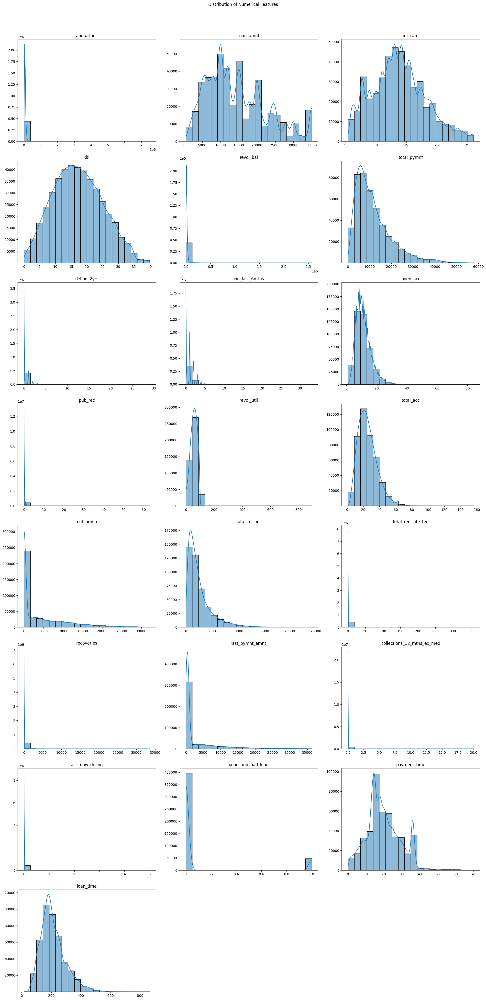

In [ ]:
import math

# Pilih hanya fitur numerik dari df_clean
numeric_features = df_clean.select_dtypes(include=['number']).columns

# Hitung jumlah baris dan kolom yang diperlukan
num_features = len(numeric_features)
rows = math.ceil(num_features / 3)
cols = 3

# Buat subplot
fig, axes = plt.subplots(nrows=rows, ncols=cols, figsize=(20, rows * 5))
axes = axes.flatten()  # Ubah ke array 1D untuk mempermudah akses
fig.suptitle('Distribution of Numerical Features', y=1.02)

# Plot histogram untuk setiap fitur numerik
for i, feature in enumerate(numeric_features):
    sns.histplot(df_clean[feature], bins=20, kde=True, ax=axes[i])
    axes[i].set_title(feature)
    axes[i].set_xlabel('')
    axes[i].set_ylabel('')

# Hapus subplot kosong jika ada
for j in range(len(numeric_features), len(axes)):
    fig.delaxes(axes[j])

# Tata letak rapi
fig.tight_layout()
plt.show()

### Categoric Features

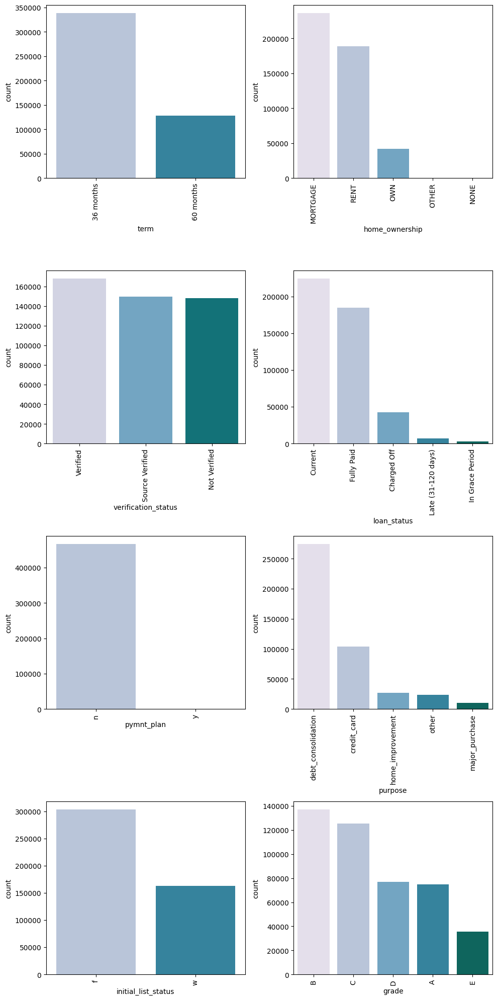

In [ ]:
fig, ax = plt.subplots(4, 2, figsize=(10, 20))

for i, subplots in zip(df_cat1, ax.flatten()):
    g = sns.barplot(x=df[i].value_counts().index[:5], y=df[i].value_counts().values[:5],ax=subplots , palette='PuBuGn')
    g.set_xticklabels(g.get_xticklabels(), rotation=90)
    g.set(xlabel=i , ylabel='count')

fig.tight_layout()
plt.show()

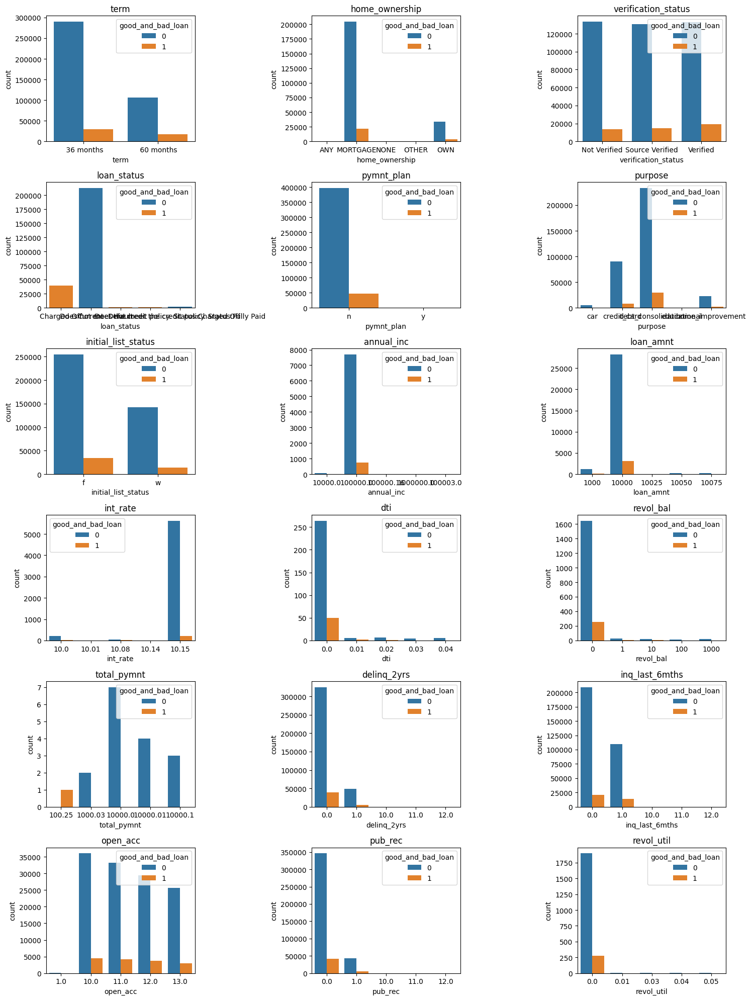

In [ ]:
rows, cols = 6, 3
fig, ax = plt.subplots(rows, cols, figsize=(15, 20))
ax = ax.flatten()  # Untuk mempermudah akses subplot

for i, f in enumerate(df_clean.columns[:18]):  # Batasi jumlah fitur ke 15
    try:
        # Ubah nilai unik menjadi string sebelum diurutkan
        a = sorted(df_clean[f].dropna().astype(str).unique().tolist())  # Hilangkan NaN sebelum sorting
        sns.countplot(x=f, data=df_clean, hue='good_and_bad_loan', order=a[:5], ax=ax[i])
        ax[i].set_title(f)
    except Exception as e:
        print(f"Error plotting {f}: {e}")

# Mengatur tata letak
fig.tight_layout()
plt.show()

In [ ]:
df_clean.isnull().sum()

,0
term,0
home_ownership,0
verification_status,0
loan_status,0
pymnt_plan,0
purpose,0
initial_list_status,0
annual_inc,0
loan_amnt,0
int_rate,0


## Multivariate Analysis

### Numeric Features

In [ ]:
filt_data = df_clean[df_clean['good_and_bad_loan']!=2]

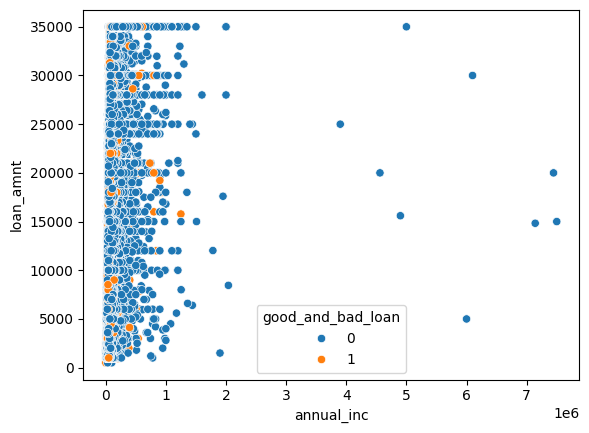

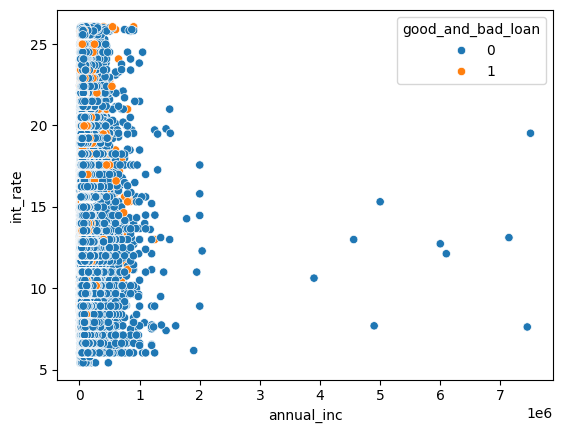

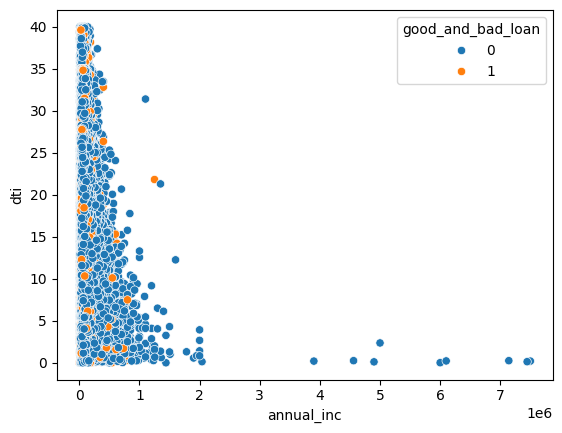

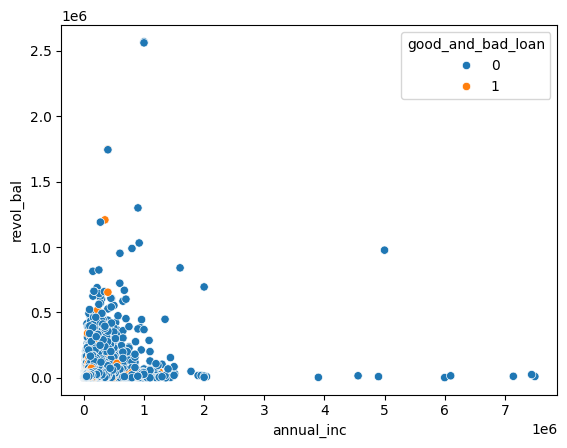

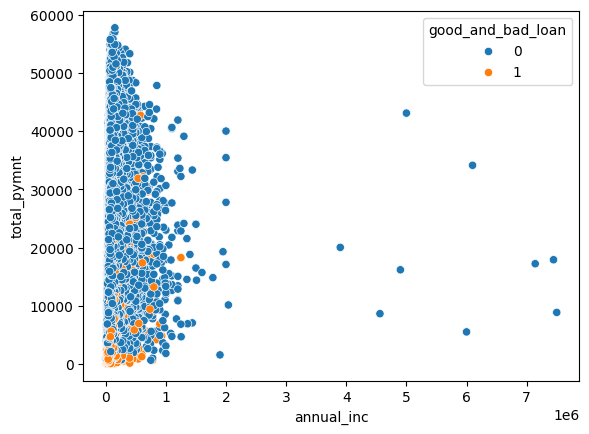

...

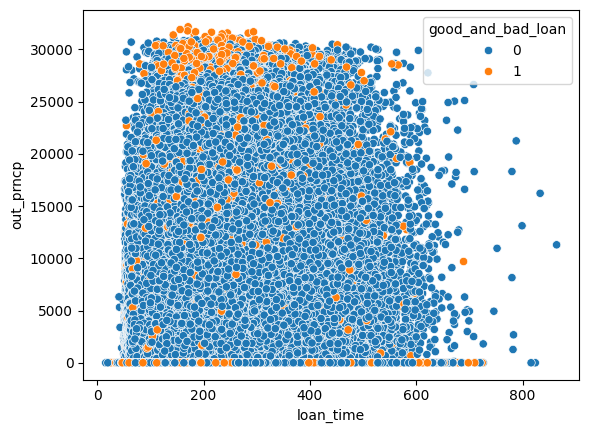

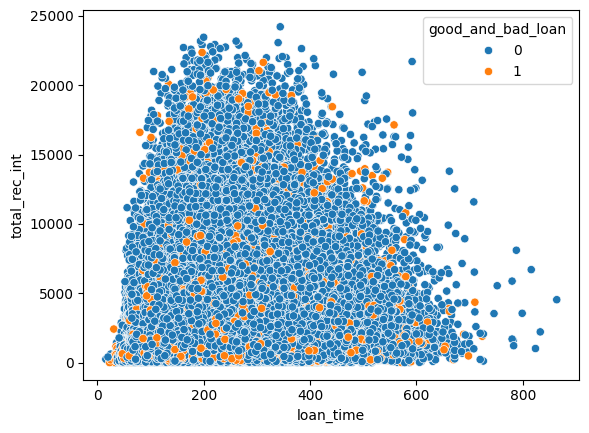

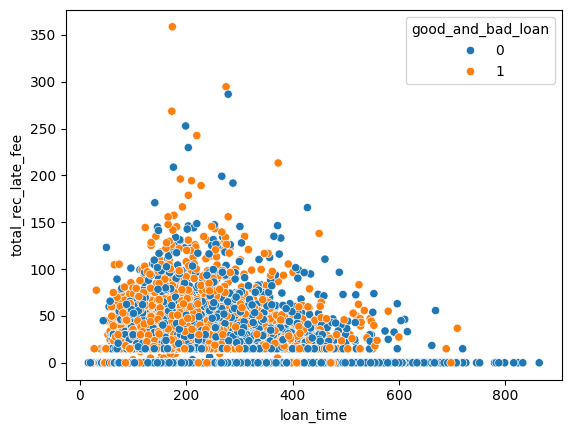

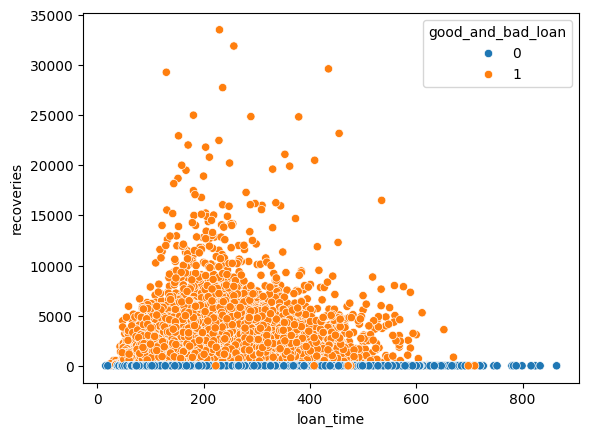

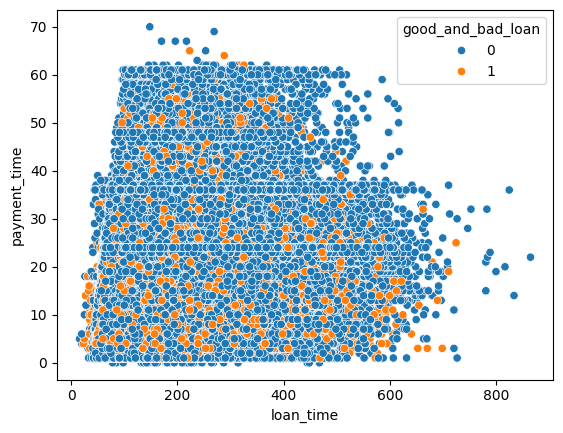

In [ ]:
for i in df_num1:
    for j in df_num1:
        if i!=j and (i < j):
            sns.scatterplot(data=filt_data, x=i, y=j, hue='good_and_bad_loan')
            plt.show()

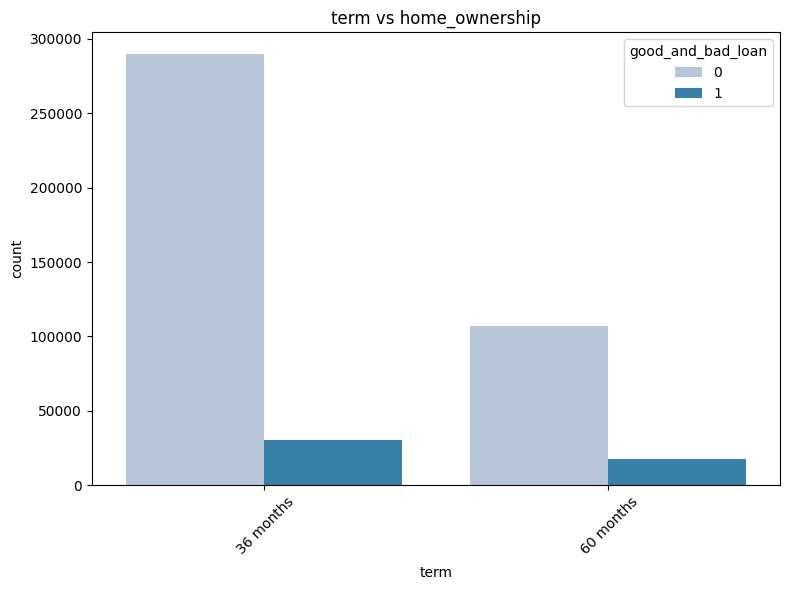

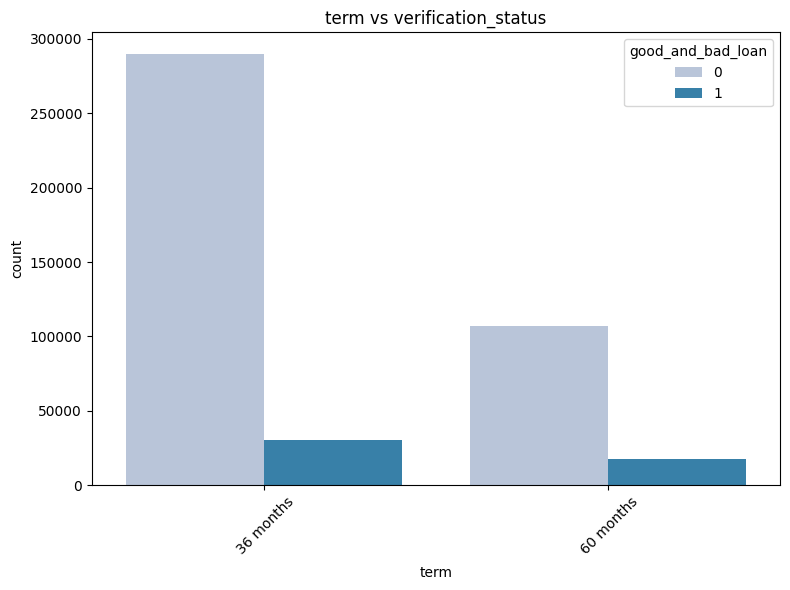

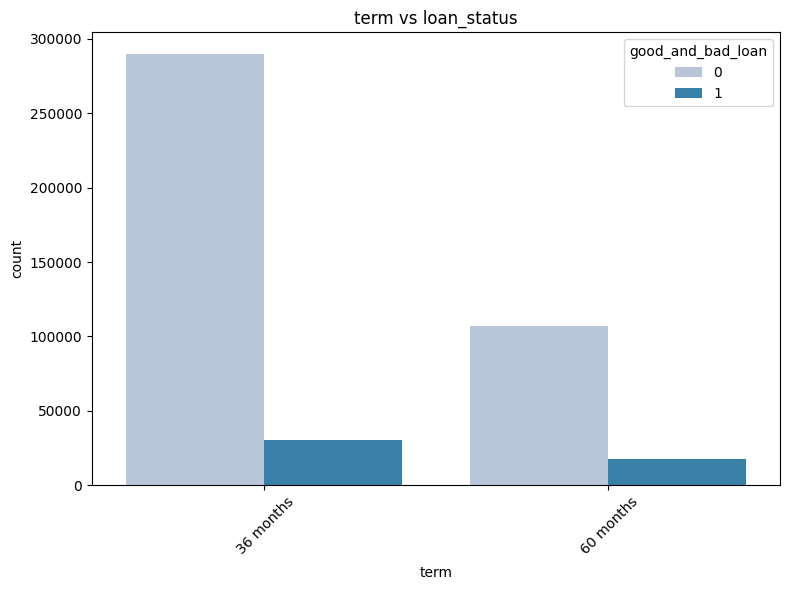

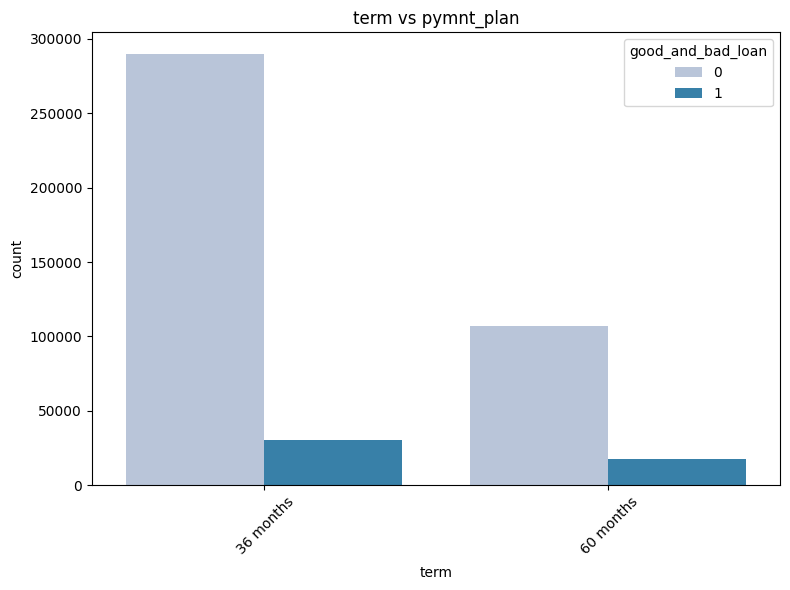

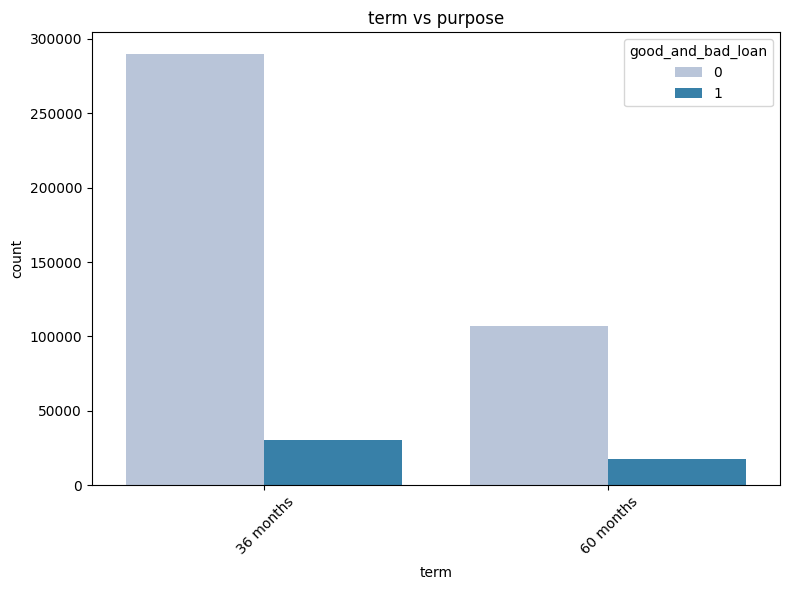

...

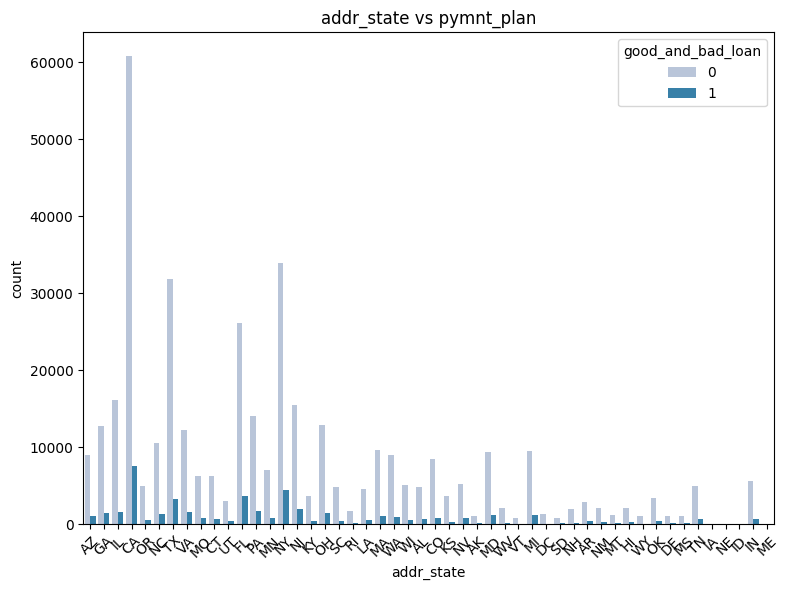

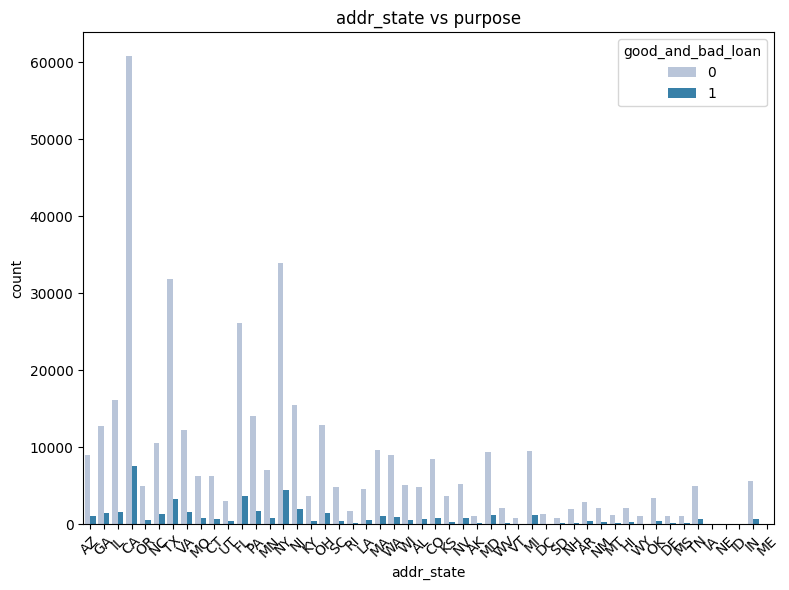

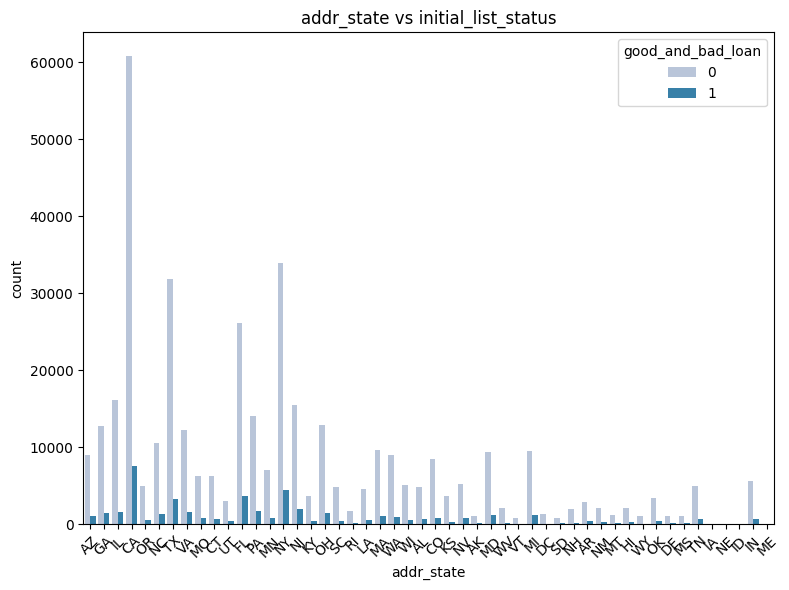

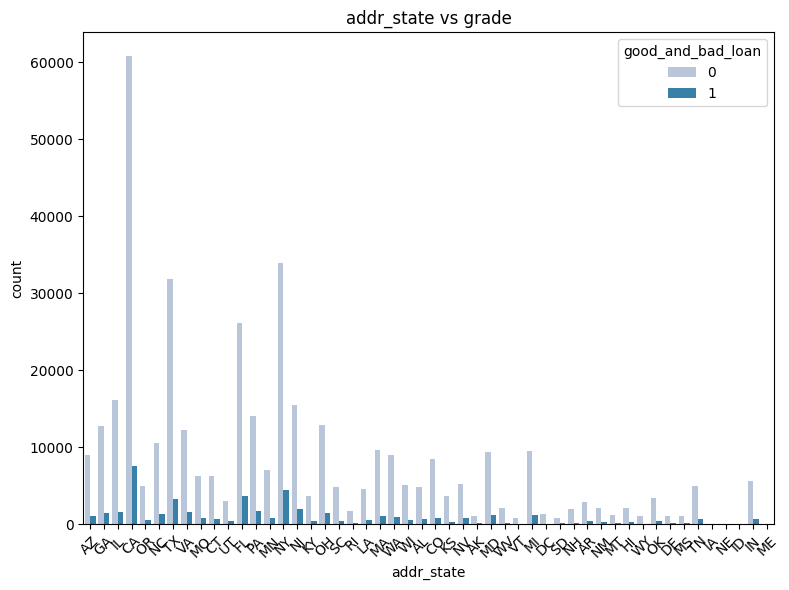

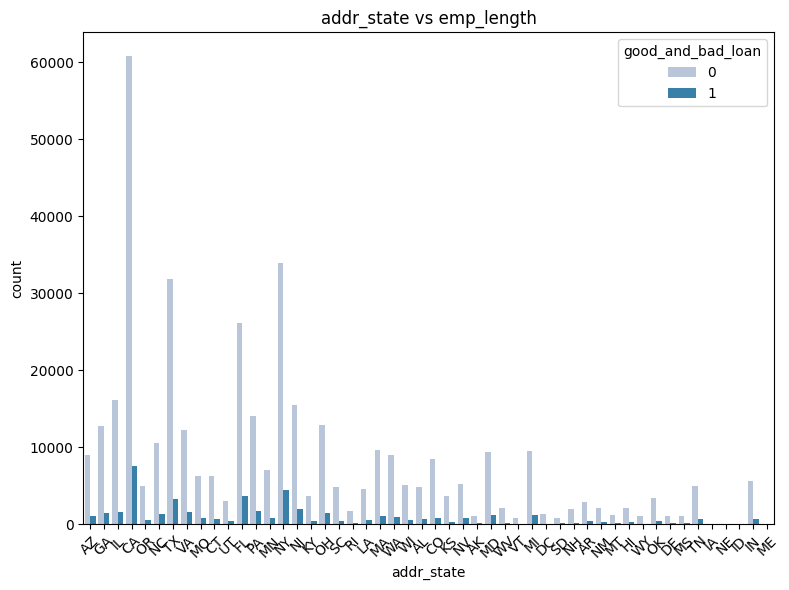

In [ ]:
categorical_features = [col for col in df_clean.select_dtypes(include='object').columns if col != 'good_and_bad_loan']

# Loop untuk pasangan kolom object
for i in categorical_features:
    for j in categorical_features:
        if i != j:
            plt.figure(figsize=(8, 6))
            sns.countplot(
                data=filt_data,
                x=i,
                hue='good_and_bad_loan',  # Gunakan kolom j sebagai kategori
                palette="PuBu"
            )
            plt.title(f"{i} vs {j}")
            plt.xticks(rotation=45)
            plt.tight_layout()
            plt.show()

### Categoric Features

# Data Preprocessing

## Handle Outliers

In [ ]:
numeric = df_clean.select_dtypes(include=['number']).columns

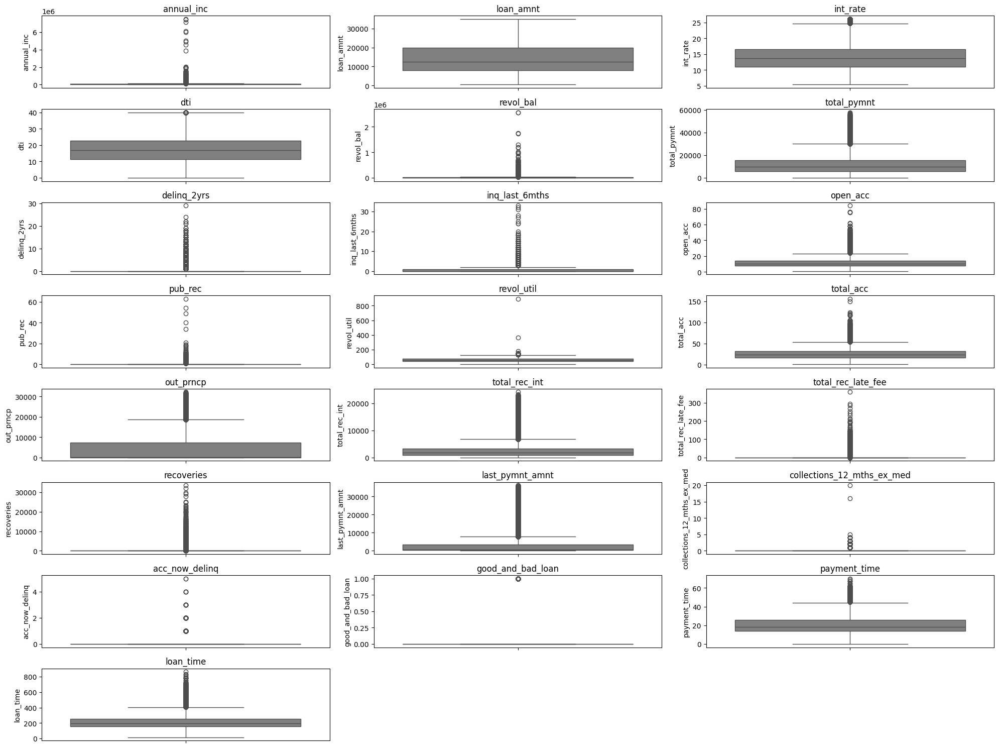

In [ ]:
plt.figure(figsize=(20, 15))

for i in range(len(numeric)):
    plt.subplot(len(numeric) // 3 + 1, 3, i + 1)  # Mengatur subplot menjadi beberapa baris
    sns.boxplot(y=df_clean[numeric[i]], color='gray', orient='v')
    plt.title(numeric[i])  # Menambahkan judul pada setiap subplot

plt.tight_layout()
plt.show()

In [ ]:
def calculate_outlier_percentage(df_clean):
    outlier_percentages = {}

    for col in df_clean.select_dtypes(include=['float64', 'int64']).columns:  # Pilih hanya fitur numerik
        Q1 = df_clean[col].quantile(0.25)  # Kuartil pertama
        Q3 = df_clean[col].quantile(0.75)  # Kuartil ketiga
        IQR = Q3 - Q1               # Interquartile Range

        # Hitung batas bawah dan batas atas untuk outlier
        lower_bound = Q1 - 1.5 * IQR
        upper_bound = Q3 + 1.5 * IQR

        # Hitung jumlah outlier
        outliers = ((df_clean[col] < lower_bound) | (df_clean[col] > upper_bound)).sum()
        total = len(df_clean[col])

        # Hitung persentase outlier
        outlier_percentage = (outliers / total) * 100
        outlier_percentages[col] = outlier_percentage

    return pd.DataFrame(outlier_percentages.items(), columns=['Feature', 'Outlier_Percentage'])

outlier_percentages = calculate_outlier_percentage(df_clean)
print(outlier_percentages)

                       Feature  Outlier_Percentage
0                   annual_inc            4.224088
1                    loan_amnt            0.000000
2                     int_rate            1.054109
3                          dti            0.032175
4                    revol_bal            4.906053
5                  total_pymnt            4.011016
6                  delinq_2yrs           17.970260
7               inq_last_6mths            7.907508
8                     open_acc            2.285966
9                      pub_rec           12.664388
10                  revol_util            0.004050
11                   total_acc            1.875572
12                   out_prncp            4.878603
13               total_rec_int            6.644152
14          total_rec_late_fee            2.301941
15                  recoveries            5.171324
16             last_pymnt_amnt           14.686208
17  collections_12_mths_ex_med            0.832488
18              acc_now_delinq 

In [ ]:
def detect_and_remove_outliers(df_clean, column):
    # Hitung Q1, Q3, dan IQR
    Q1 = df_clean[column].quantile(0.25)
    Q3 = df_clean[column].quantile(0.75)
    IQR = Q3 - Q1

    # Hitung batas bawah dan atas
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR

    # Pisahkan data ke dalam outliers dan non-outliers
    outliers = df_clean[(df_clean[column] < lower_bound) | (df_clean[column] > upper_bound)]
    df_no_outlier = df_clean[(df_clean[column] >= lower_bound) & (df_clean[column] <= upper_bound)]

    return df_no_outlier, outliers

# DataFrame awal
df_no_outlier = df_clean.copy()

# Proses pemilihan kolom
columns_to_check = ['annual_inc', 'int_rate', 'revol_bal', 'total_pymnt', 'open_acc', 'total_acc', 'out_prncp', 'total_rec_late_fee',
                    'collections_12_mths_ex_med', 'acc_now_delinq']  # Daftar kolom untuk pemeriksaan

for col in columns_to_check:
    print(f"\nProcessing column: {col}")

    # Deteksi outlier
    _, outliers = detect_and_remove_outliers(df_no_outlier, col)
    print(f"Number of outliers detected in {col}: {len(outliers)}")

    # Tampilkan beberapa outlier
    print(outliers.head())
    df_no_outlier, _ = detect_and_remove_outliers(df_no_outlier, col)

In [ ]:
outlier_percentages = calculate_outlier_percentage(df_no_outlier)
print(outlier_percentages)

                       Feature  Outlier_Percentage
0                   annual_inc            2.147095
1                    loan_amnt            0.962833
2                     int_rate            0.387353
3                          dti            0.057548
4                    revol_bal            2.508158
5                  total_pymnt            1.625366
6                  delinq_2yrs           16.838191
7               inq_last_6mths            7.319695
8                     open_acc            0.490472
9                      pub_rec           13.764193
10                  revol_util            0.003213
11                   total_acc            0.000000
12                   out_prncp            3.470114
13               total_rec_int            5.287696
14          total_rec_late_fee            0.000000
15                  recoveries            5.301718
16             last_pymnt_amnt           13.360481
17  collections_12_mths_ex_med            0.000000
18              acc_now_delinq 

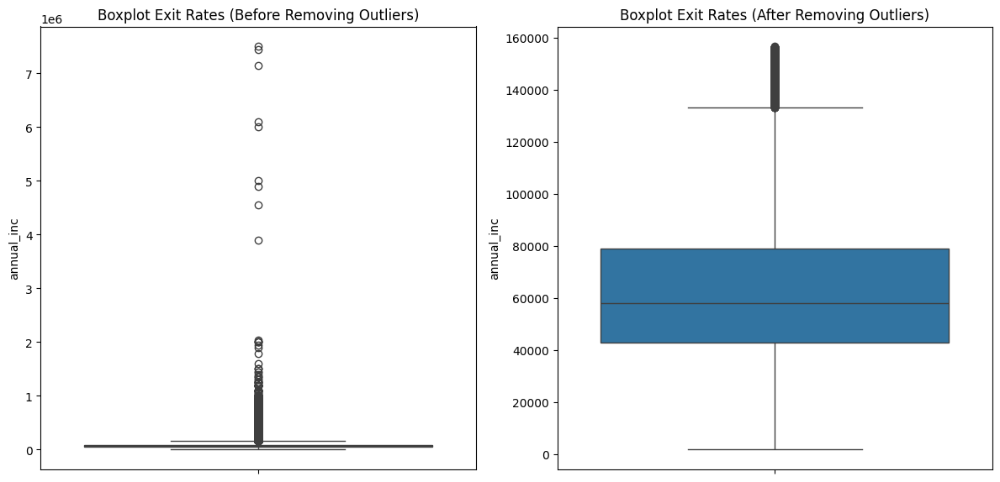

In [ ]:
plt.figure(figsize=(12, 6))

plt.subplot(1, 2, 1)
sns.boxplot(y=df_clean['annual_inc'])
plt.title('Boxplot Exit Rates (Before Removing Outliers)')

plt.subplot(1, 2, 2)
sns.boxplot(y=df_no_outlier['annual_inc'])
plt.title('Boxplot Exit Rates (After Removing Outliers)')

plt.tight_layout()
plt.show()

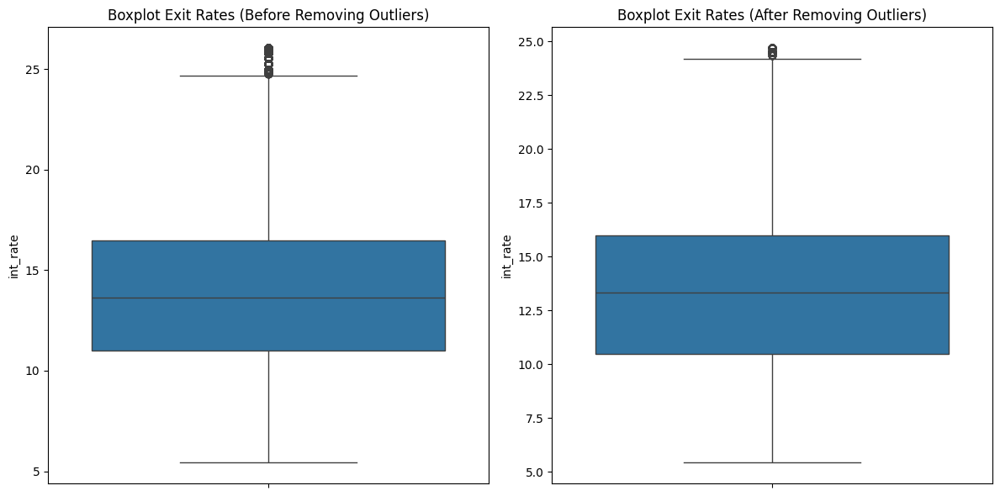

In [ ]:
# Plot boxplot sebelum dan sesudah menghapus outliers
plt.figure(figsize=(12, 6))

plt.subplot(1, 2, 1)
sns.boxplot(y=df_clean['int_rate'])
plt.title('Boxplot Exit Rates (Before Removing Outliers)')

plt.subplot(1, 2, 2)
sns.boxplot(y=df_no_outlier['int_rate'])
plt.title('Boxplot Exit Rates (After Removing Outliers)')

plt.tight_layout()
plt.show()

## Encoding

In [ ]:
from sklearn.preprocessing import OrdinalEncoder

encoder = OrdinalEncoder()
cat_cols = [col for col in df_no_outlier.select_dtypes(include='object').columns.tolist()]
df_no_outlier[cat_cols] = encoder.fit_transform(df_no_outlier[cat_cols])

In [ ]:
df_no_outlier

,term,home_ownership,verification_status,loan_status,pymnt_plan,purpose,initial_list_status,annual_inc,loan_amnt,int_rate,...,issue_d,last_pymnt_d,earliest_cr_line,last_credit_pull_d,grade,emp_length,addr_state,good_and_bad_loan,payment_time,loan_time
0,0.0,5.0,2.0,5.0,0.0,1.0,0.0,24000.0,5000,10.65,...,2011-12-01,2015-01-01,1985-01-01,2016-01-01,1.0,1.0,3.0,0,37,372
1,1.0,5.0,1.0,0.0,0.0,0.0,0.0,30000.0,2500,15.27,...,2011-12-01,2013-04-01,1999-04-01,2013-09-01,2.0,10.0,10.0,1,16,173
2,0.0,5.0,0.0,5.0,0.0,11.0,0.0,12252.0,2400,15.96,...,2011-12-01,2014-06-01,2001-11-01,2016-01-01,2.0,1.0,14.0,0,30,170
4,1.0,5.0,1.0,1.0,0.0,9.0,0.0,80000.0,3000,12.69,...,2011-12-01,2016-01-01,1996-01-01,2016-01-01,1.0,0.0,36.0,0,49,240
5,0.0,5.0,1.0,5.0,0.0,13.0,0.0,36000.0,5000,7.90,...,2011-12-01,2015-01-01,2004-11-01,2015-09-01,0.0,3.0,3.0,0,37,130
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
466280,1.0,1.0,1.0,1.0,0.0,2.0,1.0,110000.0,18400,14.47,...,2014-01-01,2016-01-01,2003-04-01,2016-01-01,2.0,4.0,42.0,0,24,153
466281,1.0,1.0,2.0,0.0,0.0,2.0,0.0,78000.0,22000,19.97,...,2014-01-01,2014-12-01,1997-06-01,2016-01-01,3.0,1.0,41.0,1,11,223
466282,1.0,1.0,2.0,1.0,0.0,2.0,0.0,46000.0,20700,16.99,...,2014-01-01,2016-01-01,2001-12-01,2015-12-01,3.0,7.0,34.0,0,24,168
466283,0.0,4.0,2.0,5.0,0.0,1.0,1.0,83000.0,2000,7.90,...,2014-01-01,2014-12-01,2003-02-01,2015-04-01,0.0,3.0,4.0,0,11,146


## Feature Transformation

In [ ]:
from sklearn.preprocessing import StandardScaler

num_cols = [
    col
    for col in df_no_outlier.columns.tolist()
    if col not in cat_cols + ['good_and_bad_loan']
    and df_no_outlier[col].dtype != 'datetime64[ns]'  # Exclude datetime columns
]

ss = StandardScaler()
# Apply StandardScaler only to the selected numerical columns
std_cols = pd.DataFrame(
    ss.fit_transform(df_no_outlier[num_cols]), columns=num_cols
)

In [ ]:
std_cols

,annual_inc,loan_amnt,int_rate,dti,revol_bal,total_pymnt,delinq_2yrs,inq_last_6mths,open_acc,pub_rec,...,total_acc,out_prncp,total_rec_int,total_rec_late_fee,recoveries,last_pymnt_amnt,collections_12_mths_ex_med,acc_now_delinq,payment_time,loan_time
0,-1.427901,-1.143129,-0.675903,1.368531,0.164420,-0.665509,-0.348143,0.208582,-1.787181,-0.324935,...,-1.421120,-0.719621,-0.680786,0.0,-0.161551,-0.564674,0.0,0.0,1.755337,2.035218
1,-1.208593,-1.540546,0.448200,-2.050156,-1.259236,-1.442141,-0.348143,3.972354,-1.787181,-0.324935,...,-1.924773,-0.719621,-0.922084,0.0,0.071490,-0.576358,0.0,0.0,-0.421400,-0.383228
2,-1.857306,-1.556442,0.616085,-1.059827,-1.108194,-1.122845,-0.348143,1.149525,-2.026051,-0.324935,...,-1.320389,-0.719621,-0.826630,0.0,-0.161551,-0.457126,0.0,0.0,1.029758,-0.419687
3,0.618975,-1.461062,-0.179546,0.122923,1.846835,-1.084670,-0.348143,-0.732361,1.079254,-0.324935,...,1.500067,-0.552117,-0.596935,0.0,-0.161551,-0.588022,0.0,0.0,2.999187,0.431022
4,-0.989285,-1.143129,-1.345011,-0.741690,-0.512236,-0.702272,-0.348143,2.090468,-0.353964,-0.324935,...,-1.118928,-0.719621,-0.810919,0.0,-0.161551,-0.567056,0.0,0.0,1.755337,-0.905807
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
342318,1.715516,0.987025,0.253550,0.367940,1.302297,0.058294,-0.348143,1.149525,1.795863,-0.324935,...,1.298606,2.026760,1.413383,0.0,-0.161551,-0.505981,0.0,0.0,0.407833,-0.626288
342319,0.545872,1.559305,1.591767,0.188346,0.710744,-0.854875,-0.348143,3.972354,1.795863,1.639926,...,0.694222,-0.719621,0.440895,0.0,-0.161551,-0.599330,0.0,0.0,-0.939671,0.224421
342320,-0.623771,1.352648,0.866696,1.111969,-0.663993,0.372096,-0.348143,1.149525,1.795863,-0.324935,...,2.003720,2.431773,2.271682,0.0,-0.161551,-0.487610,0.0,0.0,0.407833,-0.443993
342321,0.728629,-1.620029,-1.345011,-1.487003,-0.102672,-1.263223,3.611280,0.208582,2.512471,-0.324935,...,0.392030,-0.719621,-1.096918,0.0,-0.161551,-0.265821,0.0,0.0,-0.939671,-0.711359


## Split Data

In [ ]:
df_cleaned = df_no_outlier.copy()

In [ ]:
df_cleaned.drop(['issue_d', 'last_pymnt_d', 'earliest_cr_line', 'last_credit_pull_d'], axis=1, inplace=True)

In [ ]:
from sklearn.model_selection import train_test_split

X = df_cleaned.drop(['good_and_bad_loan'], axis=1)
y = df_cleaned['good_and_bad_loan']

In [ ]:
# Pisahkan data ke dalam set pelatihan dan pengujian
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42,stratify=y)

Check Class Between Good Loan and Bad Loan

<Axes: title={'center': 'Good (1) vs Bad (0) Loans Balance'}, xlabel='good_and_bad_loan'>

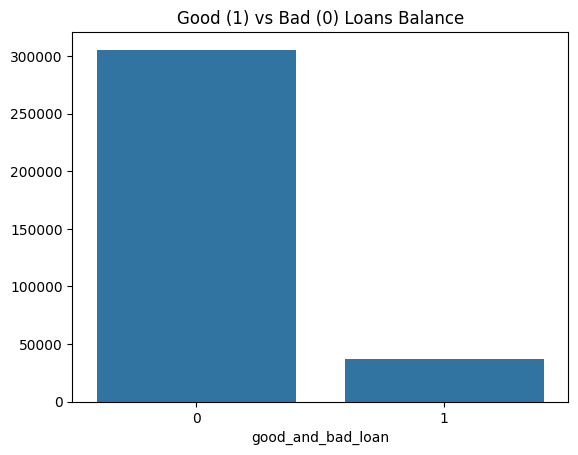

In [ ]:
#check if class labels are balanced
plt.title('Good (1) vs Bad (0) Loans Balance')
sns.barplot(x=df_cleaned.good_and_bad_loan.value_counts().index,y=df_cleaned.good_and_bad_loan.value_counts().values)

# Modelling

In [ ]:
y_train.value_counts()

,count
good_and_bad_loan,
0,244481
1,29377


In [ ]:
from imblearn.over_sampling import SMOTE

# Inisialisasi SMOTE
smote = SMOTE(random_state=42)

# Terapkan SMOTE pada data pelatihan
X_train_resampled, y_train_resampled = smote.fit_resample(X_train, y_train)

In [ ]:
y_test.value_counts()

,count
good_and_bad_loan,
0,61121
1,7344


In [ ]:
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import confusion_matrix
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score
from sklearn.model_selection import cross_validate

def eval_classification(model):
    y_pred = model.predict(X_test)
    y_pred_train = model.predict(X_train)
    y_pred_proba = model.predict_proba(X_test)
    y_pred_proba_train = model.predict_proba(X_train)
    y_actual = model.predict(X)

    print(f"Accuracy (Test Set): {accuracy_score(y_test, y_pred):.3f}")
    print(f"Accuracy (Train Set): {accuracy_score(y_train, y_pred_train):.3f}")
    print(f"Precision (Test Set): {precision_score(y_test, y_pred):.3f}")
    print(f"Precision (Train Set): {precision_score(y_train, y_pred_train):.3f}")
    print(f"Recall (Test Set): {recall_score(y_test, y_pred):.3f}")
    print(f"Recall (Train Set): {recall_score(y_train, y_pred_train):.3f}")
    print(f"F1-Score (Test Set): {f1_score(y_test, y_pred):.3f}")
    print(f"F1-Score (Train Set): {f1_score(y_train, y_pred_train):.3f}")
    print(f"ROC AUC (Test Set): {roc_auc_score(y_test, y_pred_proba[:, 1]):.3f}")
    print(f"ROC AUC (Train Set): {roc_auc_score(y_train, y_pred_proba_train[:, 1]):.3f}")

    score = cross_validate(model, X, y, cv=5, scoring='recall', return_train_score=True)
    print(f"Recall (Crossval Train): {score['train_score'].mean():.3f}")
    print(f"Recall (Crossval Test): {score['test_score'].mean():.3f}")

    cm = confusion_matrix(y, y_actual)
    print('\nConfusion Matrix:')
    print(cm)

    # Visualisasi confusion matrix
    plt.figure(figsize=(8, 6))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', cbar=False)

    # Menambahkan label pada confusion matrix
    plt.xlabel('Predicted')
    plt.ylabel('Actual')
    plt.title('Confusion Matrix')

    plt.show()

    # Menghitung conversion rate
    TP = cm[1, 1]
    FP = cm[0, 1]
    FN = cm[1, 0]
    TN = cm[0, 0]
    total_data = len(y)
    conversion_rate = ((TP+FP) / total_data) * 100
    print("\nConversion Rate (model prediction): %.2f%%" % conversion_rate)

    # Menghitung conversion rate pada data raw
    TP_raw = df_cleaned['good_and_bad_loan'].sum()
    total_data_raw = df_cleaned.shape[0]
    conversion_rate_raw = (TP_raw / total_data_raw) * 100
    print("\nConversion Rate (Raw): %.2f%%" % conversion_rate_raw)


def show_feature_importance(model):
    feat_importances = pd.Series(model.feature_importances_, index=X.columns)
    ax = feat_importances.nlargest(25).plot(kind='barh', figsize=(10, 8))
    ax.invert_yaxis()

    plt.xlabel('Score')
    plt.ylabel('Feature')
    plt.title('Feature Importance Score')
    plt.show()

def show_best_hyperparameter(model):
    params = model.best_estimator_.get_params()
    for param, value in params.items():
        if isinstance(value, float):
            print(f"{param}: {value:.3f}")
        else:
            print(f"{param}: {value}")

Accuracy (Test Set): 0.981
Accuracy (Train Set): 0.981
Precision (Test Set): 0.985
Precision (Train Set): 0.985
Recall (Test Set): 0.835
Recall (Train Set): 0.840
F1-Score (Test Set): 0.904
F1-Score (Train Set): 0.907
ROC AUC (Test Set): 0.966
ROC AUC (Train Set): 0.966
Recall (Crossval Train): 0.842
Recall (Crossval Test): 0.840

Confusion Matrix:
[[305140    462]
 [  5926  30795]]


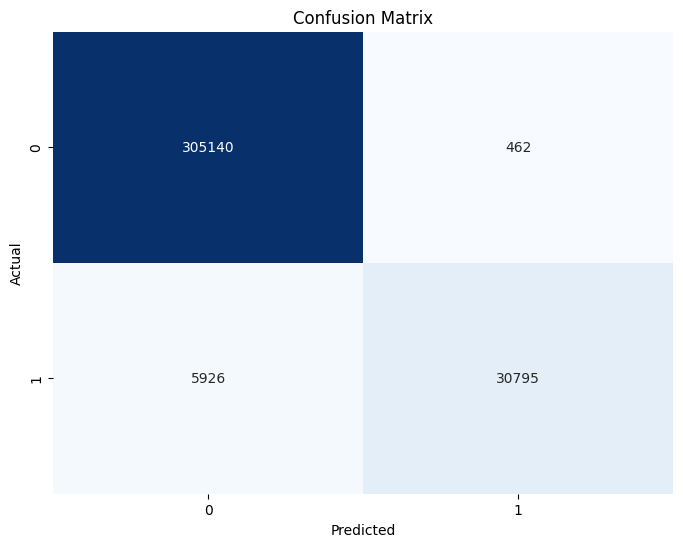


Conversion Rate (model prediction): 9.13%

Conversion Rate (Raw): 10.73%


In [ ]:
from sklearn.linear_model import LogisticRegression

log_reg = LogisticRegression()
log_reg.fit(X_train, y_train)

eval_classification(log_reg)

Accuracy (Test Set): 0.946
Accuracy (Train Set): 0.946
Precision (Test Set): 0.999
Precision (Train Set): 0.999
Recall (Test Set): 0.501
Recall (Train Set): 0.495
F1-Score (Test Set): 0.667
F1-Score (Train Set): 0.662
ROC AUC (Test Set): 0.943
ROC AUC (Train Set): 0.942
Recall (Crossval Train): 0.497
Recall (Crossval Test): 0.498

Confusion Matrix:
[[305590     12]
 [ 18488  18233]]


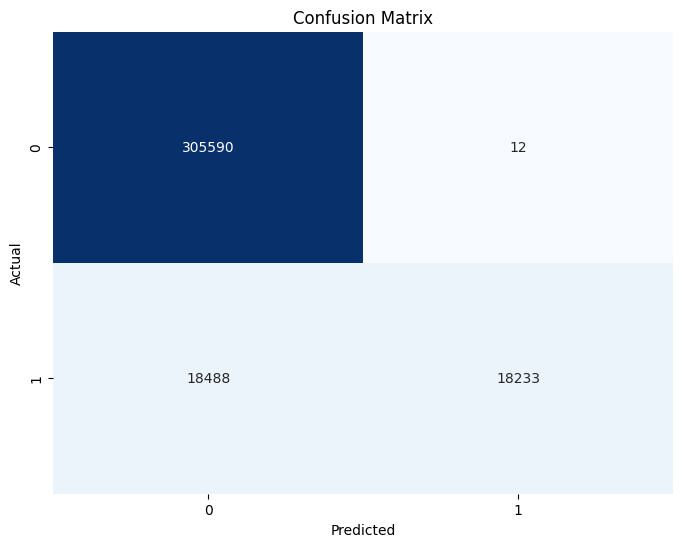


Conversion Rate (model prediction): 5.33%

Conversion Rate (Raw): 10.73%


In [ ]:
from sklearn.naive_bayes import GaussianNB

nb1 = GaussianNB()
nb1.fit(X_train, y_train)
eval_classification(nb1)

# Kesimpulan

1. **Melakukan Oversampling** : Alasannya adalah karena data tersebut memiliki hasil yang tidak seimbang, hanya 22% data yang merupakan pinjaman berisiko.
2. **Memberikan tambahan kolom** : Untuk mendapatkan informasi yang lebih lengkap perlunya kolom lebih banyak. Peminjam yang memberikan informasi lebih lengkap cenderung memiliki motivasi lebih besar untuk membayar pinjaman tepat waktu. Terutama untuk kategori pinjaman usaha kecil, yang secara statistik memiliki risiko lebih tinggi. Dengan adanya deskripsi atau informasi tambahan dapat menjadi indikator bahwa peminjam memiliki rencana atau komitmen yang lebih jelas terhadap pengelolaan pinjaman mereka. Hal ini dapat menjadi pertimbangan penting bagi tim bisnis dalam mengevaluasi kelayakan pinjaman.

# Rekomendasi

1. **Mengidentifikasi Pola Risiko Berdasarkan Total Pembayaran**
 *   Data menunjukkan bahwa peminjam yang memenuhi kewajiban pembayaran cenderung memiliki total pembayaran yang stabil dan konsisten sejak awal hingga akhir masa pinjaman.
 *   **Rekomendasi** : Tetap lakukan pemantauan terhadap pola pembayaran untuk memastikan stabilitas. Selain itu, tawarkan program insentif, seperti diskon bunga atau bonus loyalitas, bagi peminjam yang melunasi pinjaman lebih awal atau tepat waktu.
2. **Segmen Berdasarkan Tujuan Pinjaman**
 *   Sebagian besar peminjam menggunakan pinjaman untuk melunasi utang sebelumnya, dan kelompok ini menunjukkan kinerja pembayaran yang konsisten dan baik.
 *   **Rekomendasi** : Tambahkan analisis mendalam untuk memahami pola pengelolaan keuangan peminjam yang baik ini. Gunakan temuan tersebut untuk mengembangkan program insentif yang dapat mendorong peminjam melunasi pinjaman lebih awal atau meningkatkan loyalitas.

